In [1]:
#Reade and plot UIRAPUEU_20230203_08200_59.fit
# Path: UIRAPURE_READER.ipynb
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.visualization import simple_norm
from astropy.visualization import ZScaleInterval
from astropy.visualization import ImageNormalize
from astropy.visualization import LinearStretch
from astropy.visualization import LogStretch
from astropy.visualization import SqrtStretch
from astropy.visualization import PowerStretch
from astropy.visualization import AsinhStretch
from astropy.visualization import SinhStretch
from astropy.visualization import HistEqStretch
from astropy.visualization import ManualInterval
from astropy.visualization import PercentileInterval

from json import JSONEncoder
import json

In [2]:
class NumpyArrayEncoder(JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return JSONEncoder.default(self, obj)

In [3]:
# Read FITS file
hdul = fits.open('UIRAPURU_20230203_082000_59.fit')
hdul.info()
image_data = hdul[0].data

#print hdul reader
hdul[0].header

Filename: UIRAPURU_20230203_082000_59.fit
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      42   (1800, 400)   uint8   
  1                1 BinTableHDU     16   1R x 2C   [1800D8.3, 400D8.3]   


SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                    8 / number of bits per data pixel                  
NAXIS   =                    2 / number of data axes                            
NAXIS1  =                 1800 / length of data axis 1                          
NAXIS2  =                  400 / length of data axis 2                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
COMMENT  File created by e-Callisto for Unix version 1.1.0                      
DATE    = '2023-02-03'         / Time of observation                            
CONTENT = '2023/02/03  Radio flux density, e-CALLISTO (UIRAPURU)' / Title of ima
ORIGIN  = 'PB_BRA  '           / Organization name                              
TELESCOP= 'Radio Spectromete

In [4]:
#CREATE A DATAFRAME

import pandas as pd
from astropy.time import Time
#create a dataframe with the keys in columns

df = pd.DataFrame.from_dict(hdul[0].header, orient='index')
df = df.transpose()

date_initial = df['DATE-OBS'].values[0] +' ' + df['TIME-OBS'].values[0]
date_initial = date_initial.replace('/', '-') #change the '/' to '-'
initial_time = Time(date_initial, format='iso', scale='utc').jd

date_final = df['DATE-END'].values[0] +' ' + df['TIME-END'].values[0]
date_final = date_final.replace('/', '-') #change the '/' to '-'
final_time = Time(date_final, format='iso', scale='utc').jd


delta_t = (final_time - initial_time)/len(hdul[0].data)

#Add a new column with with name "delta_t" and value delta_t
df['delta_t'] = float(delta_t)
    
wfall = np.transpose(hdul[0].data)
df['water_fall'] = ""#json.dumps(wfall[0], cls=NumpyArrayEncoder)
sample_row = df.iloc[0].copy()

for i in range(len(wfall)):
    aux_var = sample_row
    aux_var['water_fall'] = json.dumps(wfall[i], cls=NumpyArrayEncoder)
    aux_var['delta_t']    = float(initial_time + delta_t*i)
    df.loc[i] = aux_var

df

,SIMPLE,BITPIX,NAXIS,NAXIS1,NAXIS2,EXTEND,COMMENT,COMMENT,COMMENT,DATE,...,COMMENT,OBS_LAT,OBS_LAC,OBS_LON,OBS_LOC,OBS_ALT,FRQFILE,PWM_VAL,delta_t,water_fall
0,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[157, 157, 157, 156, 156, 157, 156, 156, 157, ..."
1,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[157, 158, 157, 156, 157, 158, 157, 157, 156, ..."
2,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[157, 157, 157, 157, 157, 158, 156, 156, 156, ..."
3,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[156, 158, 158, 157, 158, 158, 157, 157, 157, ..."
4,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[157, 157, 156, 158, 157, 158, 157, 156, 156, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1795,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[156, 158, 157, 157, 157, 156, 157, 157, 156, ..."
1796,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[157, 156, 156, 157, 157, 156, 157, 156, 157, ..."
1797,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[158, 158, 157, 157, 156, 156, 156, 156, 155, ..."
1798,True,8,2,1800,400,True,FITS (Flexible Image Transport System) forma...,"and Astrophysics', volume 376, page 359; bib...",File created by e-Callisto for Unix version 1...,2023-02-03,...,Warning: the value of CDELT2 may be rounded!,7.212,S,35.908,W,553.0,frq00400.cfg,150,2.459979e+06,"[158, 158, 158, 156, 157, 157, 156, 156, 156, ..."


In [5]:
import pandas as pd
import json
import numpy as np
from astropy.time import Time

# Function to get Julian date
def get_julian_date(date, time):
    date_time_str = f"{date} {time}".replace('/', '-')
    return Time(date_time_str, format='iso', scale='utc').jd

# Initialize dataframe from hdul[0].header (assuming hdul is defined earlier)
df = pd.DataFrame([hdul[0].header])

# Compute initial and final Julian dates
initial_time = get_julian_date(df['DATE-OBS'].values[0], df['TIME-OBS'].values[0])
final_time = get_julian_date(df['DATE-END'].values[0], df['TIME-END'].values[0])

# Compute delta_t
delta_t = (final_time - initial_time) / len(hdul[0].data)
df['delta_t'] = delta_t

# Initialize water_fall
wfall = np.transpose(hdul[0].data)
df['water_fall'] = None

# Create new rows
new_rows = []
for i, wf in enumerate(wfall):
    new_row = df.iloc[0].copy()
    new_row['water_fall'] = json.dumps(wf.tolist())  # Assuming NumpyArrayEncoder converts to list
    new_row['delta_t'] = float(initial_time + delta_t * i)
    new_rows.append(new_row)

# Efficiently append new rows to the dataframe
df = pd.concat([df] + new_rows, ignore_index=True)

# Final DataFrame
print(df)


       BITPIX  BSCALE   BUNIT  BZERO  CDELT1  CDELT2  \
0         8.0     1.0  digits    0.0     0.5    -1.0   
1         NaN     NaN     NaN    NaN     NaN     NaN   
2         NaN     NaN     NaN    NaN     NaN     NaN   
3         NaN     NaN     NaN    NaN     NaN     NaN   
4         NaN     NaN     NaN    NaN     NaN     NaN   
...       ...     ...     ...    ...     ...     ...   
70196     NaN     NaN     NaN    NaN     NaN     NaN   
70197     NaN     NaN     NaN    NaN     NaN     NaN   
70198     NaN     NaN     NaN    NaN     NaN     NaN   
70199     NaN     NaN     NaN    NaN     NaN     NaN   
70200     NaN     NaN     NaN    NaN     NaN     NaN   

                                                 COMMENT  \
0      [  FITS (Flexible Image Transport System) form...   
1                                                    NaN   
2                                                    NaN   
3                                                    NaN   
4                          

In [6]:
len(wfall)

1800

In [7]:
import plotly.graph_objects as go
import numpy as np

heatmap = go.Heatmap(
    z=image_data,
    colorscale='Viridis',  # You can choose a different color scale
    showscale=False,       # Hide the color scale if desired
)

# Create the layout
layout = go.Layout(
    title='imshow-like Plot in Plotly',
)

# Create the figure
fig = go.Figure(data=[heatmap], layout=layout)

# Show the figure
fig.show()

In [8]:
for i in range(10):    
    plt.plot(json.loads(df['water_fall'][i]))
    plt.title(df.delta_t[i])
    plt.show()

TypeError: the JSON object must be str, bytes or bytearray, not NoneType

In [9]:

vetor = df['water_fall']

#Convert the string to a list
vetor = json.loads(vetor[0])
plt.plot(vetor)

TypeError: the JSON object must be str, bytes or bytearray, not NoneType

<class 'numpy.ndarray'>
(400, 1800)


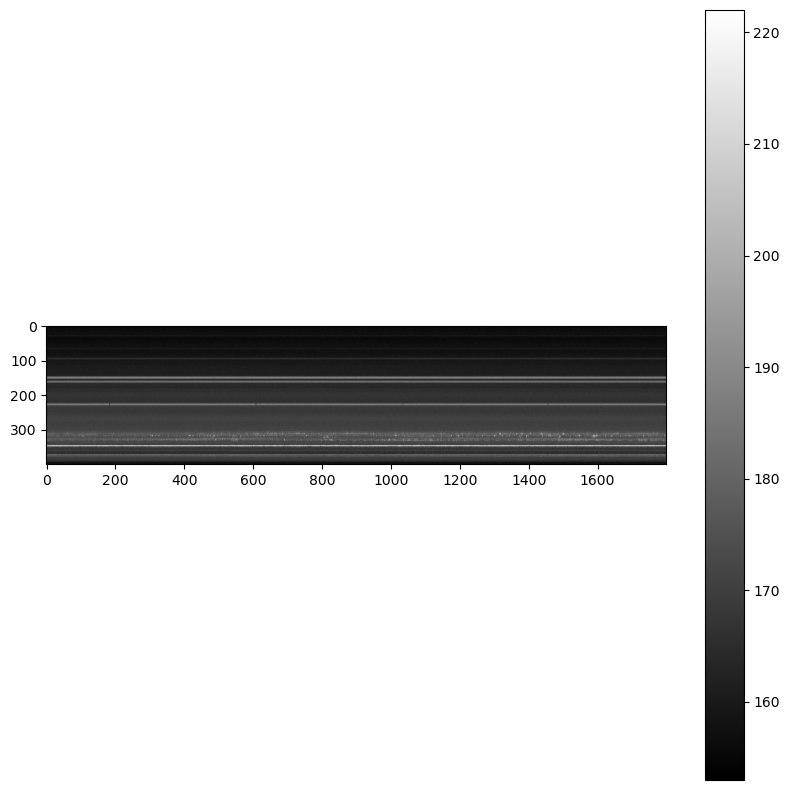

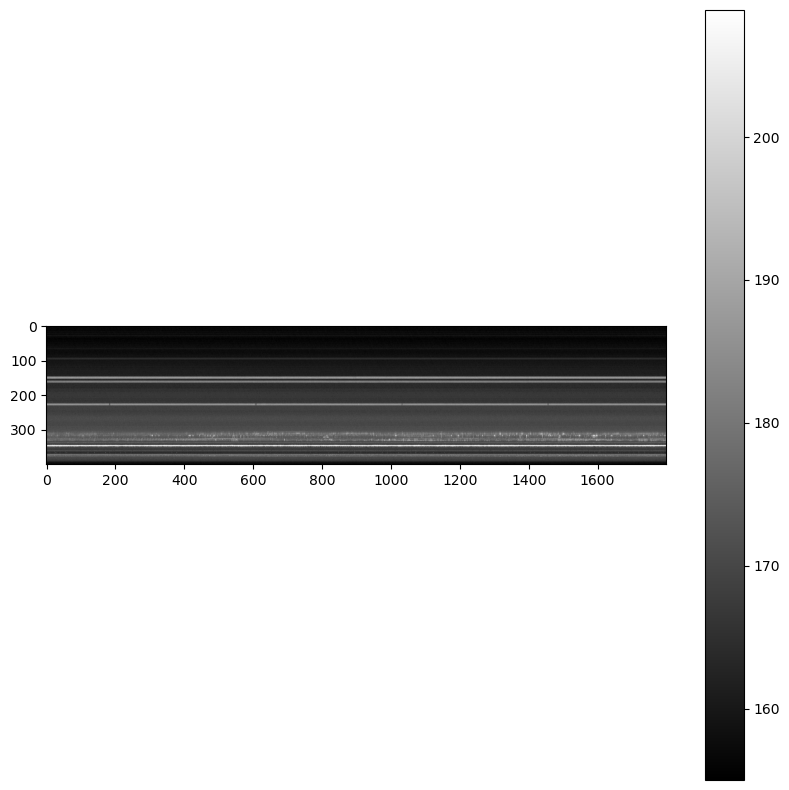

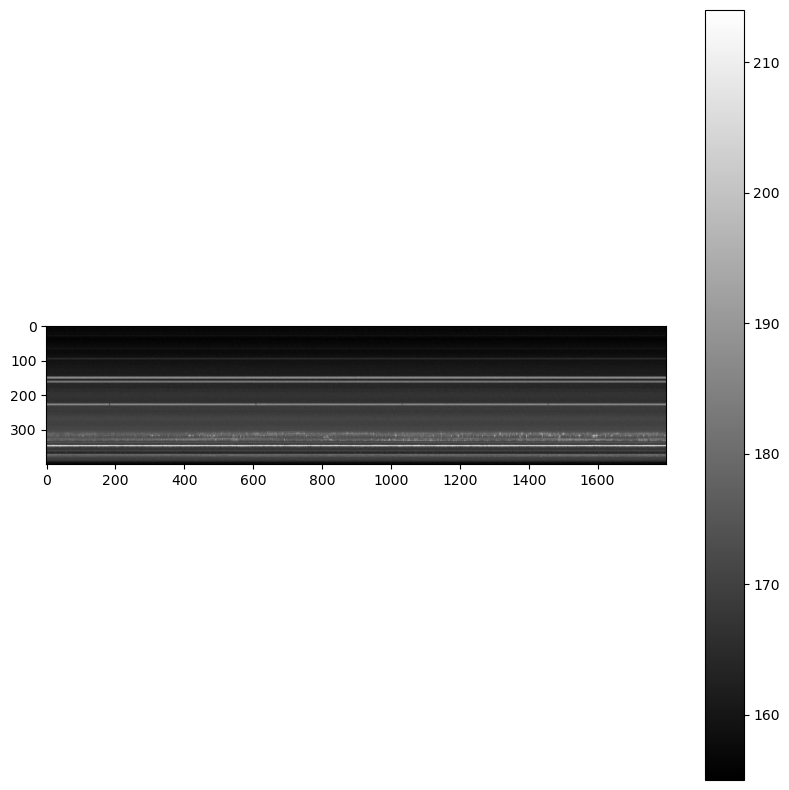

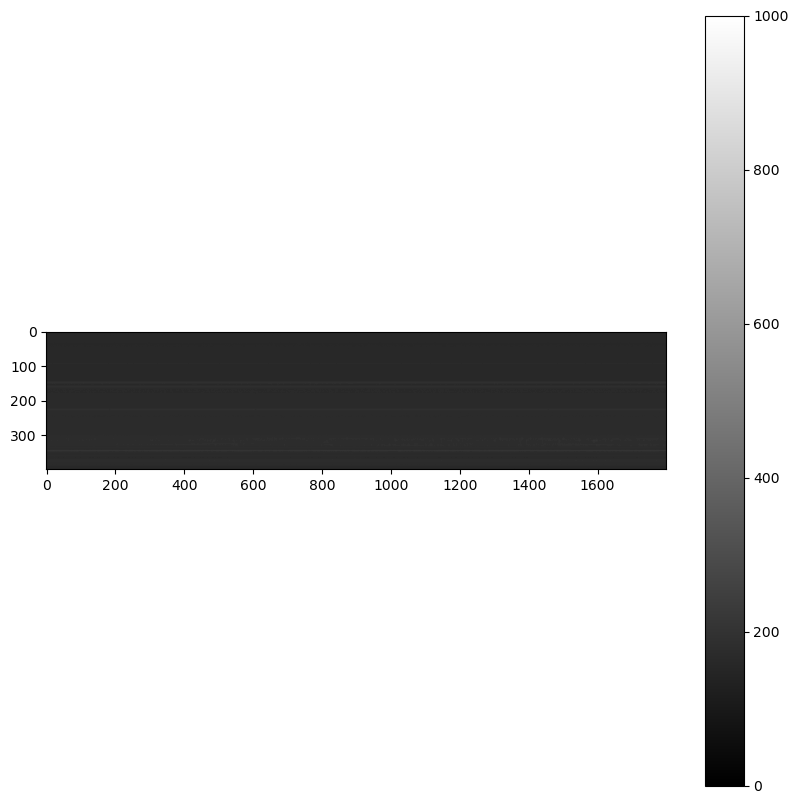

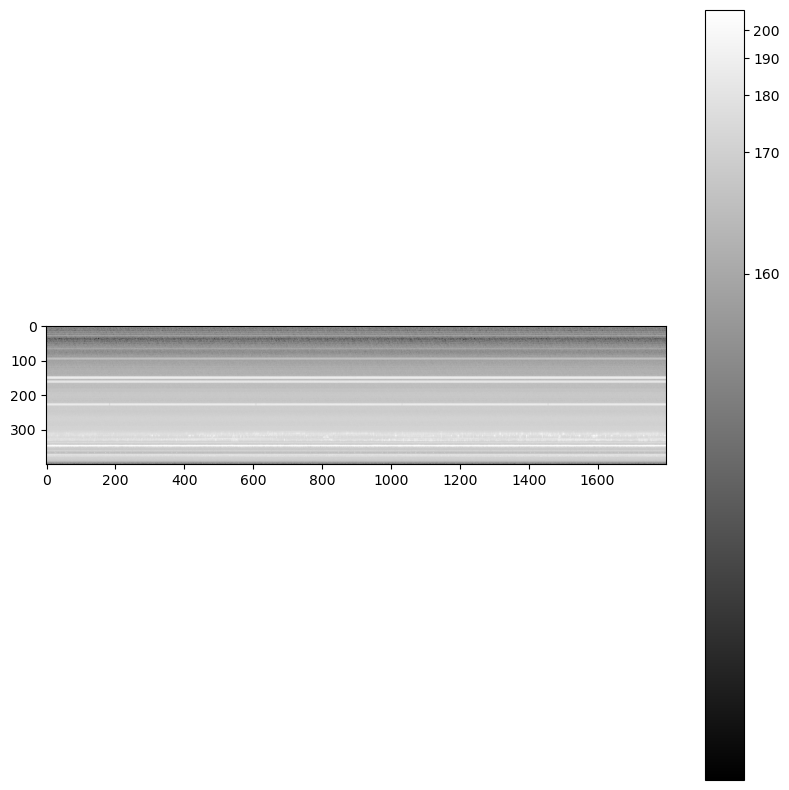

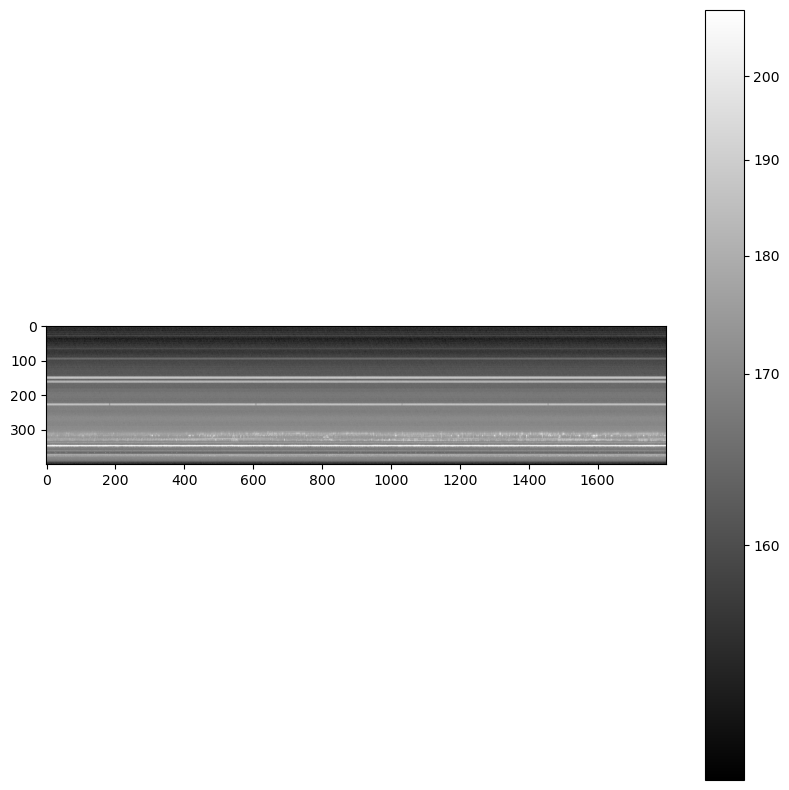

In [10]:


print(type(image_data))
print(image_data.shape)

# Plot FITS file
plt.figure(figsize=(10,10))
plt.imshow(image_data, cmap='gray')
plt.colorbar()
plt.show()

# Plot FITS file with ZScaleInterval
plt.figure(figsize=(10,10))
norm = ImageNormalize(image_data, interval=ZScaleInterval(), stretch=LinearStretch())
plt.imshow(image_data, cmap='gray', norm=norm)
plt.colorbar()
plt.show()

# Plot FITS file with PercentileInterval
plt.figure(figsize=(10,10))
norm = ImageNormalize(image_data, interval=PercentileInterval(99.5), stretch=LinearStretch())
plt.imshow(image_data, cmap='gray', norm=norm)
plt.colorbar()

# Plot FITS file with ManualInterval
plt.figure(figsize=(10,10))
norm = ImageNormalize(image_data, interval=ManualInterval(0, 1000), stretch=LinearStretch())
plt.imshow(image_data, cmap='gray', norm=norm)
plt.colorbar()
plt.show()

# Plot FITS file with LogStretch
plt.figure(figsize=(10,10))
norm = ImageNormalize(image_data, interval=ZScaleInterval(), stretch=LogStretch())
plt.imshow(image_data, cmap='gray', norm=norm)
plt.colorbar()
plt.show()

# Plot FITS file with SqrtStretch
plt.figure(figsize=(10,10))
norm = ImageNormalize(image_data, interval=ZScaleInterval(), stretch=SqrtStretch())
plt.imshow(image_data, cmap='gray', norm=norm)
plt.colorbar()
plt.show()




(400, 1800)

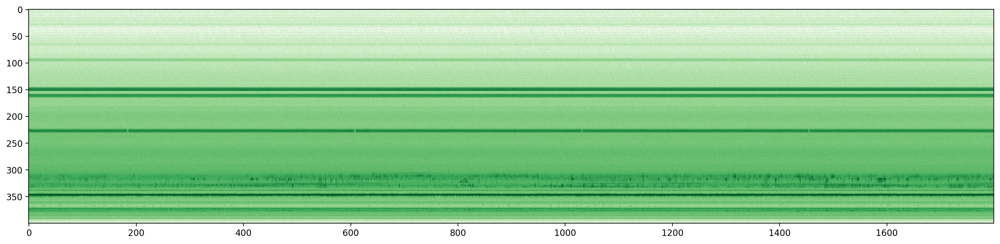

In [11]:
plt.figure(figsize=(20,10),dpi=200)
plt.imshow(image_data, cmap='Greens', norm=norm)
image_data.shape

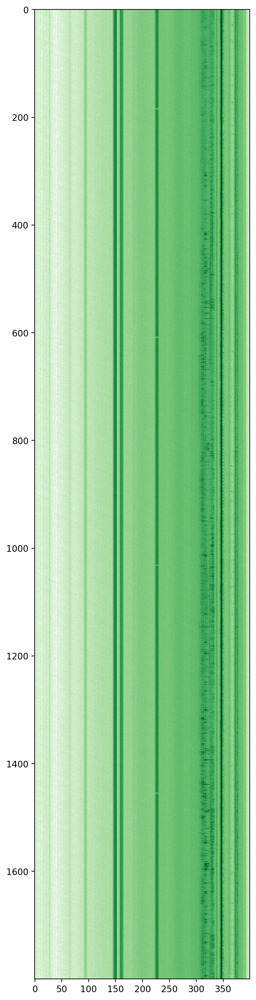

In [12]:
image_data_trans = np.transpose(image_data)
plt.figure(figsize=(10,20),dpi=200)
plt.imshow(image_data_trans, cmap='Greens', norm=norm)

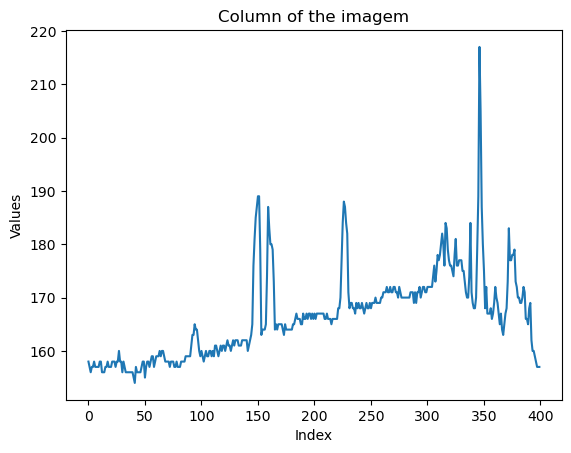

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Read column 666
column = image_data[:, 666]

# Plot the column
plt.plot(column)
plt.title("Column of the imagem")
plt.xlabel("Index")
plt.ylabel("Values")
plt.show()


